# Matrix decomposition on STFT

This notebook is inspired by [`librosa.decompose.decompose`](https://librosa.org/doc/latest/generated/librosa.decompose.decompose.html#librosa.decompose.decompose).

[Non-negative matrix factorisation](https://scikit-learn.org/stable/modules/decomposition.html#nmf) (NMF) is another *decomposition* algorithm such as PCA.
The goal of decomposition algorithms is to find a product of matrices that give an approximation of our original matrix $M$.

Lets assume we have a STFT representation of our signal stored in a matrix $S$ is a $m \times n$ matrix, where $m$ is the number of frequency bins and $n$ the number of STFT windows.
We also need to assume that $S$ has non-negative vaules which we can take care of by taking the [absolute value](https://en.wikipedia.org/wiki/Absolute_value).
NMF tries to find two matrices $W$ with dimensions $m \times j$ and $H$ with dimensions $j \times n$ such that

$$
\underbrace{W}_{m \times j} ~~ \underbrace{H}_{j \times n} \approx \underbrace{S}_{m \times n}
$$

where we call $j$ the number of components.

Note that when selecting $j < m, n$ we can reduce the number of stored values in our matrices drastically because $M$ has $n \cdot m$ entries and our NMF approximation has $(m \cdot j) + (j \cdot n)$ - this behaviour can be seen as a simple compression algorithm which is non-transparent (also called lossy compression like MP3 in comparsion to FLAC or ZIP).

The [wikipedia article about NMF](https://en.wikipedia.org/wiki/Non-negative_matrix_factorization) goes more into detail on the specifics of the algorithm.

We will use NMF for a unique compression aesthetic and also for a special kind of material-dependent [filter bank](https://en.wikipedia.org/wiki/Filter_bank).

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import librosa
import librosa.display
from IPython.display import display, Audio

# mute sklearn warnings for cleaner output
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

mpl.rcParams['figure.figsize'] = (15, 5)

np.random.seed(42)

## Load data

We are using librosa to load our audio signal into an array and to calculate the STFT of our signal.

In [ ]:
data, sr = librosa.load('violin.flac', mono=True, sr=None)
data_stft = librosa.stft(data)
data_stft

array([[-1.34611517e-01+0.0000000e+00j, -8.81930739e-02+0.0000000e+00j,
         3.51221934e-02+0.0000000e+00j, ...,
         2.01530978e-02+0.0000000e+00j, -4.11255611e-03+0.0000000e+00j,
        -2.00920701e-02+0.0000000e+00j],
       [-5.73719107e-02-7.4132324e-18j,  2.04126105e-01+4.2520456e-02j,
        -1.87015161e-01+8.2122266e-02j, ...,
        -3.28111439e-03-1.4741326e-02j,  7.85400905e-03-5.4899026e-03j,
         1.09950192e-02-1.1893314e-02j],
       [ 2.99066544e-01+2.3310347e-18j, -2.82269061e-01-3.0442452e-02j,
         2.47283325e-01-9.2679501e-02j, ...,
         3.44552025e-02-3.2594778e-02j, -3.80797200e-02-2.2905620e-02j,
        -1.34105782e-03+4.3304265e-02j],
       ...,
       [-7.26644706e-04-6.4510029e-18j,  9.97982803e-04-4.2362604e-04j,
        -9.88743268e-04-5.8851878e-05j, ...,
         4.18621261e-04+2.3323249e-04j, -3.51753377e-04+4.7834383e-05j,
        -1.12803944e-04-5.8451097e-04j],
       [-5.88731898e-04+1.9109063e-18j, -8.97194957e-04+7.8539946e-0

As NMF stands for non-negative matrix factorization we need to transfer our FFT matrix into a purely positive one but right now the matrix consists of puerly complex values which encode amplited and phase.

A common way to turn a complex number $z \in \mathbb{C}$ into a real number $a \in \mathbb{R}_{\geq 0}$ is to use its absolute value which is defined by

$$
|z| = |x + iy| = \sqrt{x^2 + y^2}
$$

where $x$ is the real part of $z$ and $y$ the imaginary part and therefore mimics the euclidian distance in a 2 dimensional space.

In [ ]:
data_stft_abs = np.abs(data_stft)
data_stft_abs

array([[1.3461152e-01, 8.8193074e-02, 3.5122193e-02, ..., 2.0153098e-02,
        4.1125561e-03, 2.0092070e-02],
       [5.7371911e-02, 2.0850769e-01, 2.0425165e-01, ..., 1.5102066e-02,
        9.5825093e-03, 1.6196955e-02],
       [2.9906654e-01, 2.8390592e-01, 2.6408055e-01, ..., 4.7429744e-02,
        4.4437964e-02, 4.3325026e-02],
       ...,
       [7.2664471e-04, 1.0841719e-03, 9.9049322e-04, ..., 4.7920889e-04,
        3.5499095e-04, 5.9529638e-04],
       [5.8873190e-04, 1.1923972e-03, 1.1457060e-03, ..., 4.5880937e-04,
        3.6517816e-04, 5.1450328e-04],
       [1.4549928e-03, 6.4460182e-04, 7.7734480e-04, ..., 6.1549962e-04,
        1.4162884e-04, 5.3095102e-04]], dtype=float32)

We need to make ourselves aware that transforming the complex STFT matrix into a purely real positive matrices has already altered our sound drastically which can be verified by applying the reverse STFT on it.

In [ ]:
display(Audio(librosa.istft(data_stft_abs), rate=sr))

## Decompose STFT signal

After we have transformed the STFT matrix into a non-negative representation we can now use the NMF algorithm to find an approximation of our signal which uses far less data to store the signal comparing to the original signal.

In [ ]:
from sklearn.decomposition import NMF

# we define init to avoid a deprecation warning
nmf = NMF(n_components=16, random_state=42, max_iter=2000, init='nndsvda')

Now we can calculate the approximation $S \approx WH$ as discussed earlier.

In [ ]:
W = nmf.fit_transform(data_stft_abs)
H = nmf.components_
print(f"Shape of W: {W.shape}")
print(f"Shape of H: {H.shape}")
print(f"Shape of S: {data_stft_abs.shape}")

Shape of W: (1025, 16)
Shape of H: (16, 2380)
Shape of S: (1025, 2380)


To now obtain the approximated signal we can simply multiply both matrices and apply the inverse STFT on it.

In [ ]:
approx_stft = np.matmul(W, H)
approx_signal = librosa.istft(approx_stft)
display(Audio(approx_signal, rate=sr))

Let us take a closer look at the interemdiate representation $W$ and $H$ of our signal which uses 16 components which we can interpret as intermediate domain.
Where $W$ describes 16 mixtures of frequency bins $H$ maps those 16 mixtures to our time domain.

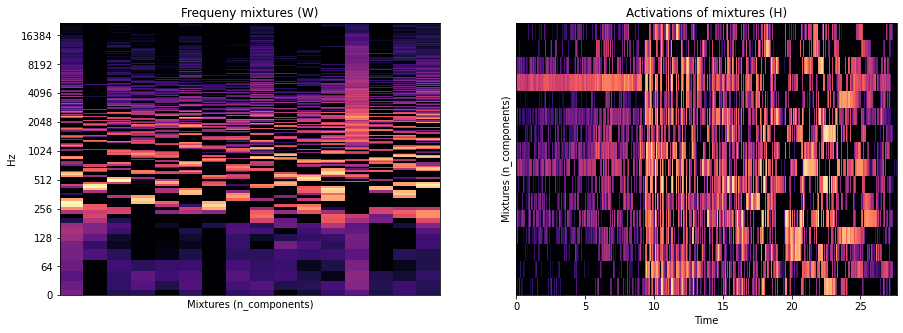

In [ ]:
plt.subplot(1, 2, 1)
plt.title("Frequeny mixtures (W)")
librosa.display.specshow(librosa.amplitude_to_db(W, ref=np.max), y_axis='log', sr=sr)
plt.xlabel("Mixtures (n_components)")

plt.subplot(1, 2, 2)
plt.title("Activations of mixtures (H)")
librosa.display.specshow(librosa.amplitude_to_db(H, ref=np.max), x_axis='time', sr=sr);
plt.ylabel("Mixtures (n_components)")

plt.show()

We can also see which frequency mixtures are the most used and therefore probably most dominante.
Please keep in mind that the occurences of these mixtures are not linearly independent - maybe only the comibnation of those mixtures are present in our signal and not single occurences.

We can sum the activations of each frequency bin and sort them by indices ([argsort](https://numpy.org/doc/stable/reference/generated/numpy.argsort.html)).

In [ ]:
np.argsort(np.sum(H, axis=1))

array([14, 15, 11,  5,  2,  1,  0,  8, 10, 13,  9,  3, 12,  7,  4,  6])

We can now modify both matrices by applying transformations on them - e.g. by rasing the amplitudes by power of 2 and taking the log of our activations.

In [ ]:
# as log(0) is undefined we add a bias term
approx_lin_log_stft = np.matmul(np.power(W, 2.0), np.log(H+0.0001))
approx_lin_log_signal = librosa.istft(approx_lin_log_stft)
display(Audio(approx_lin_log_signal, rate=sr))

We can also deactivate the $n$ most used mixtures.

In [ ]:
# returns all mixtures except the 4 most used ones
mixtures_wo_most_used = np.argsort(np.sum(H, axis=1))[:-4]
reduced_fft = np.matmul(W[:, mixtures_wo_most_used], H[mixtures_wo_most_used, :])
reduced_signal = librosa.istft(reduced_fft)
display(Audio(reduced_signal, rate=sr))

We can also compare the size of our reduced version versus the original signal.

In [ ]:
print("Size of WH is {:.2%} of original signal".format((np.size(W)+np.size(H))/np.size(data_stft)))

Size of WH is 2.23% of original signal


## Splitting complex and imaginary component

Instead of reducing the complex STFT representation to non-negative real representation we can split the real and imaginary part of the complex representation and perform a NMF on both parts.

We are repeating the steps from above for each part.

In [ ]:
data_stft_real = np.abs(np.real(data_stft))
data_stft_imag = np.abs(np.imag(data_stft))

In [ ]:
real_nmf = NMF(n_components=8, init='nndsvda')
imag_nmf = NMF(n_components=8, init='nndsvda')

real_W = real_nmf.fit_transform(data_stft_real)
real_H = real_nmf.components_

imag_W = imag_nmf.fit_transform(data_stft_imag)
imag_H = imag_nmf.components_

In [ ]:
real_reconstruct = np.matmul(real_W, real_H)
imag_reconstruct = np.matmul(imag_W, imag_H)

# j is i in python - see
# https://stackoverflow.com/questions/24812444/why-are-complex-numbers-in-python-denoted-with-j-instead-of-i
complete_recontstruct = real_reconstruct + 1j * imag_reconstruct
complete_signal = librosa.istft(complete_recontstruct)
display(Audio(complete_signal, rate=sr))

## Exchanging components

The activation of mixtures re-assambles a filter bank which is used e.g. on a vocoder.
Instead of using fixed banks we adjust them dependent on our signal.
Finding a good aproximation is taks of the NMF algorithm.

Using the terminology of the vocoder we use a carrier (the matrix $W$ with its activations) and a modulator (the matrix $H$ with its mixtures) signal.
We can now exchange the modulator $H$ and the carrier $W$ with a modulator $H_{d}$ and $W_{d}$ from a different signal.

For this section we will introduce a now sound from freesound.org called [Gretsch snare + Ludwig kit - 4 - upbeat](https://freesound.org/people/bigjoedrummer/sounds/128886/).

In [ ]:
drums, _ = librosa.load('drums.flac', sr=sr)
display(Audio('drums.flac'))

As before we will also calculate a NMF representation of the drum recording.

In [ ]:
drums_stft = librosa.stft(drums)
drums_stft_abs = np.abs(drums_stft)

drums_nmf = NMF(n_components=16, init='nndsvda', max_iter=2000)

drums_W = drums_nmf.fit_transform(drums_stft_abs)
drums_H = drums_nmf.components_

display(Audio(librosa.istft(np.matmul(drums_W, drums_H)), rate=sr))

Before we interchang the representations we start to order the components by the sum of their activations - so the mixtures are replaced according to their usage.

In [ ]:
W_ordered = W[:, np.argsort(np.sum(H, axis=1))]
H_ordered = H[np.argsort(np.sum(H, axis=1)), :]

drums_W_ordered = drums_W[:, np.argsort(np.sum(drums_H, axis=1))]
drums_H_ordered = drums_H[np.argsort(np.sum(drums_H, axis=1)), :]

We can now calculate $W_d H$

In [ ]:
display(Audio(librosa.istft(np.matmul(drums_W_ordered, H_ordered)), rate=sr))

and $HW_d$

In [ ]:
display(Audio(librosa.istft(np.matmul(W_ordered, drums_H_ordered)), rate=sr))

We can also mix both material by alternating the representation of both material.
The mixtures with an even index come from the violin signal and the mixtures with on odd index come from the drum signal.

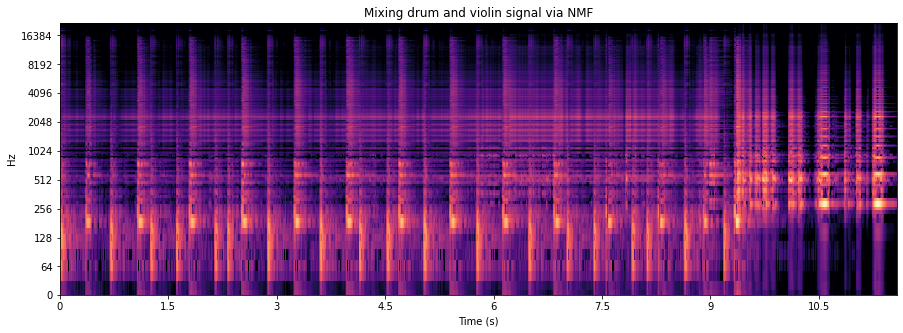

In [ ]:
# we need to calculate the shortest time of both signals
# in order to mix them
min_time = min(len(H[0]), len(drums_H[0]))

mixed_W = np.empty(shape=W.shape)
mixed_H = np.empty(shape=(len(H), min_time))

# 0::2 means start at 0, go to the end and use a step size of 2, so
# start:end:step_size
mixed_W[:, 0::2] = W_ordered[:, 0::2]
mixed_W[:, 1::2] = drums_W_ordered[:, 1::2]

mixed_H[0::2, :] = H_ordered[0::2, 0:min_time]
mixed_H[1::2, :] = drums_H_ordered[1::2, 0:min_time]

mixed_signal = np.matmul(mixed_W, mixed_H)

plt.title("Mixing drum and violin signal via NMF")
librosa.display.specshow(
    librosa.amplitude_to_db(mixed_signal, ref=np.max),
    sr=sr,
    y_axis='log',
    x_axis='s'
)
plt.show()

display(Audio(librosa.istft(mixed_signal), rate=sr))

We can also take a look when which activations of mixtures are active.

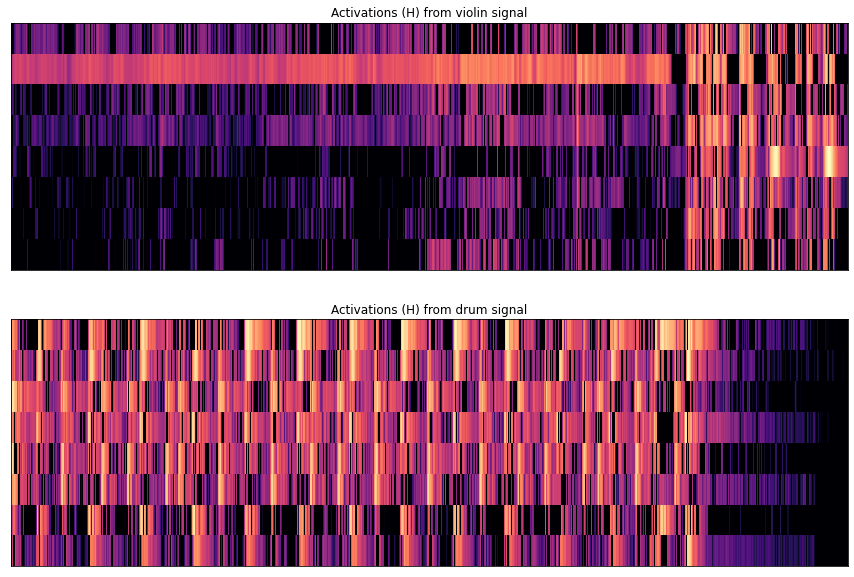

In [ ]:
plt.figure(figsize=(15, 10))
plt.subplot(2, 1, 1)
plt.title("Activations (H) from violin signal")
ax = librosa.display.specshow(
    librosa.amplitude_to_db(mixed_H[::2, :], ref=np.max)
)
plt.subplot(2, 1, 2)
plt.title("Activations (H) from drum signal")
ax = librosa.display.specshow(
    librosa.amplitude_to_db(mixed_H[1::2, :], ref=np.max)
)

## Next steps

We could continue here by trying to match the mixtures by the similarity of their frequency content or by their activations.
And also it is worth experimenting with the parameters of STFT and the non-negative representation of it.
Also writing this into a class allows us to re-use and combine this way of working with signal and quickly change parameters of the algorithm.

## NMF and machine learning

NMF is a simple but powerful aproach for a variety of data-related problems such as recommender systems, outlier prediction, data-reduction and topic-cluster detection.

A good explanation on how the idea of a low intermediate dimensional representation (in our case the mixtures of frequencies) can be used for recommender systems can be found at the excellent coursera course [Machine Learning by Andrew Ng](https://www.coursera.org/lecture/machine-learning/vectorization-low-rank-matrix-factorization-CEXN0) from Stanford University.

If we want to classify a corpora of books into categories we could naïvely just enumerate all words in the corpora (also called a dictionary) and represent each book by a vector of the size of our dictionary which just encodes how often each word is encountered in the book.
The problem of this representation of a book is the number of dimensions that are necessary due our increasing dictionary and we will soon experience [the course of dimensionality](https://en.wikipedia.org/wiki/Curse_of_dimensionality) which almost all machine learning algorithms can not handle.
We could instead assume that book which fall into the same categories share the same vocabularity - so instead of representing a book by every word it uses we switch to a combination of words that are used which allows us to lower the dimension of our data - exactly what NMF is for.
Another interesting result is that the resulitng mixtures of words can also be interpreted as a [modelling of a topic](https://en.wikipedia.org/wiki/Topic_model) which is often used to detect a topic cluster in social network messages.

Representing written language in a mathematical system [can be quite complex](https://www.tensorflow.org/tutorials/text/word_embeddings?hl=en) but led to remarkable results such as [BERT](https://arxiv.org/abs/1810.04805) or [GPT-3](https://arxiv.org/abs/2005.14165) which yield results which were unimaginable a few years ago.

Also the idea of deflating our material into a lower dimensional representation (also called [latent space](https://towardsdatascience.com/understanding-latent-space-in-machine-learning-de5a7c687d8d)) and inflating it to its original representation again can be fruitful as it allows us to modify this intermediate representation.
When using NMF on a spectogram we have not seen remarkable seperation and detection of patterns yet - the seperation works on a really low level basis (amplitude of frequencies) and not on higher levels of abstractions such as a hit on a snare drum.
But neural networks tackle the task of learning higher level representations in our signal and can lead to a much higher level abstraction in our latent space and therefore by modifying this latent space representation it allows us to generate new examples.
One neural network architecture which takes this into account are [Auto-Encoder](https://en.wikipedia.org/wiki/Autoencoder) which are a counterpart to the infamous [GANs](https://en.wikipedia.org/wiki/Generative_adversarial_network).